# Courses_Curriculum_Design_with_NLP_and_Clustering

Objective:
1. Understand how to clean and prepare data for machine learning, including transforming 
unstructured web-scaped data into structured data for analysis. Convert categorical features into 
numerical features and perform data standardization/normalization, if necessary, prior to modeling.
2. Understand how to apply unsupervised machine learning algorithms (clustering) to the task of 
grouping similar items.
3. Interpret your modeling results and visualize those.
4. Improve on skill and competencies required to collate and present domain specific, evidence-based 
insights.

### Import Packages and Properties setting

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import math
import warnings
import seaborn as sns
from nltk.corpus import stopwords
from sklearn.naive_bayes import MultinomialNB
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import accuracy_score
from wordcloud import WordCloud
from textblob import Word
from nltk.corpus import stopwords
## nltk_data is stored in 'C:\Users\lenovo\AppData\Roaming\nltk_data'
# nltk.download('stopwords')
# nltk.download('wordnet')
from collections import Counter
from collections import defaultdict
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# Kill warning
warnings.simplefilter("ignore")
# Set relative path
print (os.path.abspath('.'))
# Properties setting
plt.style.use('ggplot')

e:\OneDrive - University of Toronto\U of T\1 2022 Fall\MIE1624H Introduction to Data Science and Analytics\Assignment\Assignment 3


### 1.Data collection and cleaning

#### a) Adapt provided web-scraping code

- Modification in web-scraping code

In [2]:
# # Ensure that the driver path is correct before running this script.
# # Microsoft Windows
# driver_path = r"C:\Program Files\Google\Chrome\Application\chromedriver.exe"
# # Linux
# #driver_path = "./drivers/linux/geckodriver"
# driver = webdriver.Chrome(executable_path=driver_path)

# ## Enter a job position
# positions = 'Data+Science'
# ## Enter a location (City, State or Zip or remote)
# locations = "Toronto"
# State = "ON"

# def get_url(positions, locations, State):
#     url_template = "https://ca.indeed.com/jobs?q={}&l={}%2C+{}"
#     url = url_template.format(positions, locations, State)
#     return url

# url = get_url(positions, locations, State)
# dataframe = pd.DataFrame(columns=["Title", "Company", "Location", "Rating", "Date", "Salary", "Description", "Links"])

# # postings = 1000
# # ...

# driver = webdriver.Chrome(executable_path=driver_path)
# descriptions=[]
# count = 0
# for i in Links_list:
#     count+=1
#     if count%100==0:
#         print(count)
#     driver.get(i)
#     driver.implicitly_wait(random.randint(1, 3))
#     jd = driver.find_element(By.XPATH, '//div[@id="jobDescriptionText"]').text
#     descriptions.append(jd)
#     time.sleep(random.randint(1,3))
# driver.quit()

# dataframe['Descriptions'] = descriptions

# # Convert the dataframe to a csv file
# date = datetime.today().strftime('%Y-%m-%d')
# dataframe.to_csv("webscraping_results_assignmnet3.csv", index=False)

#### b) Save results of Indeed web-scraping to webscraping_results_assignmnet3.csv file

In [3]:
# list file under root
os.listdir()

['Auxiliary files',
 'backup',
 'huang_1008696591_assignment3.ipynb',
 'Indeed_webscraping.ipynb',
 'MIE1624 - Assignment 3.pdf',
 'Report',
 'webscraping_results_assignmnet3.csv']

#### c) Read webscraping_results_assignmnet3.csv file to your Jupyter notebook

In [4]:
# read csv
data = pd.read_csv('webscraping_results_assignmnet3.csv')
print(data.shape) # data shape
data

(1364, 9)


,Title,Company,Location,Rating,Date,Salary,Description,Links,Descriptions
0,Data Science and Analytics Manager,GALE Partners,"Toronto, ON",3.9,EmployerActive 1 day ago,NaN,"1-2 years of experience leading, mentoring, an...",https://ca.indeed.com/pagead/clk?mo=r&ad=-6NYl...,Data Science Manager\nGALE is a creative media...
1,Data Scientist,Charger Logistics Inc,"Brampton, ON",3.3,PostedPosted 3 days ago,NaN,Extract data using data mining techniques to u...,https://ca.indeed.com/pagead/clk?mo=r&ad=-6NYl...,Charger Logistics is a world class asset-based...
2,"Senior Manager, Web Analytics",GALE Partners,"Hybrid remote in Toronto, ON",3.9,EmployerActive 1 day ago,NaN,Analysis of website data and other related dat...,https://ca.indeed.com/pagead/clk?mo=r&ad=-6NYl...,GALE is a creative media consultancy that brin...
3,Machine Learning Intern (Summer 2023) - Remote,Dropbox,"Remote in Toronto, ON+1 location",NaN,PostedPosted 17 days ago,"$11,000 a month",You can expect to learn how to collaborate wit...,https://ca.indeed.com/pagead/clk?mo=r&ad=-6NYl...,"Role Description As a Dropbox intern, you are ..."
4,"Data Science Co-op, NA Integrated Analytics (2...",Munich Re,"Hybrid remote in Toronto, ON",4.0,PostedPosted 30+ days ago,NaN,Network with existing data science groups at M...,https://ca.indeed.com/rc/clk?jk=8f89137f10c047...,"Data Science Co-op, NA Integrated Analytics (2..."
...,...,...,...,...,...,...,...,...,...
1359,Product Manager - Safety AI,Veeva Systems,"Toronto, ON",NaN,PostedPosted 30+ days ago,NaN,Degree in computer science or engineering.\nEx...,https://ca.indeed.com/rc/clk?jk=f95a746d3ce431...,Veeva [NYSE: VEEV] is the leader in cloud-base...
1360,Postdoctoral Fellow in Advanced Machine Learni...,Sunnybrook Health Sciences Centre,"Toronto, ON",4.1,PostedPosted 30+ days ago,NaN,"Science, biomedical engineering, neuroscience,...",https://ca.indeed.com/rc/clk?jk=734a8a54b535ed...,Postdoctoral Fellow in Advanced Machine Learni...
1361,Senior Data Analyst (Microsoft tech stack),BDO,"Toronto, ON",3.6,PostedPosted 30+ days ago,NaN,Engage and lead (own) data advisory engagement...,https://ca.indeed.com/rc/clk?jk=0c37ab180c094a...,"Putting people first, every day:\nBDO is a fir..."
1362,"Project Manager ( AI Machine Learning, Vendor ...",TD SYNNEX,"Toronto, ON",NaN,PostedPosted 6 days ago,NaN,Develop and manage project plans with objectiv...,https://ca.indeed.com/rc/clk?jk=045027c23be3ab...,Project Manager\n\nJoin a well-established tea...


### 2.Exploratory data analysis and feature engineering

#### a) Extract data for technical/hard skills, business/soft skills, position title, company, and any other relevant information from job postings texts.

Experiment with different Natural Language Processing (NLP) algorithms to extract skills (features) from
the web-scarped job postings. You may manually define your own list of keywords/key-phrases (N-grams) 
that represent skills, e.g., “Python”, “R”, “deep learning”, “problem solving”, “communications”, 
“teamwork”, or use pre-trained NLP algorithms that automatically extract skills/features from your dataset.

##### a1) Plot top stop and non-stop words in job descriptions before removing stopwords

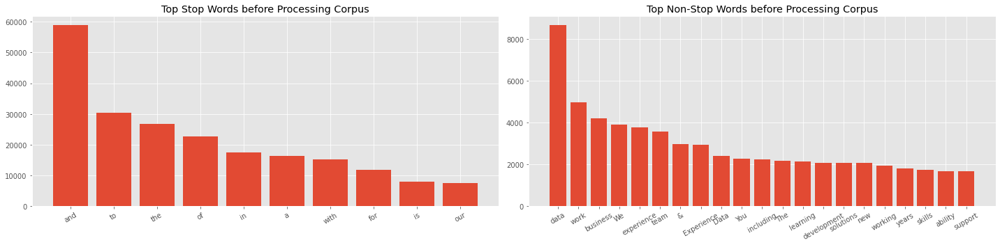

In [5]:
# plot top stop words in job descriptions
stop = stopwords.words('english')
desc_word = data['Descriptions'].str.split()
desc_words = desc_word.values.tolist()
corpus = [word for i in desc_words for word in i] # descriptions corpus
freq_dict = defaultdict(int) # get freq
for word in corpus:
    if word in stop: # check in stop corpus
        freq_dict[word] += 1 # if in, count 1 
top_stop = sorted(freq_dict.items(), key=lambda x:x[1], reverse=True)[:10] # sort, top 10
x_stop, y_stop = zip(*top_stop) # zip to x and y of plot
plt.figure(figsize=(20,5))
plt.subplot(1,2,1)
plt.bar(x_stop, y_stop)
plt.xticks(rotation=30)
plt.title('Top Stop Words before Processing Corpus')

# plot top non-stop words in job descriptions
counter = Counter(corpus) # count words in descriptions corpus
most = counter.most_common() # get most common nonstop words
x_nonstop, y_nonstop = [], []
for word,count in most[:50]: # top 50 
    if (word not in stop): # check not in stop corpus
        x_nonstop.append(word)
        y_nonstop.append(count)
plt.subplot(1,2,2)
plt.bar(x_nonstop, y_nonstop)
plt.xticks(rotation=30)
plt.title('Top Non-Stop Words before Processing Corpus')

plt.tight_layout()
plt.show()

##### a2) Tilte preprocessing
- Maunually process the title
- Convert all text to lower cases
- Delete all tabulation, spaces, and new lines
- Delete all numericals
- Delete nltk's defined stop words
- Lemmatize text
- Maunually delete stop words

In [6]:
# Maunually process the title
for i,title in enumerate(data.Title):
    data.Title[i] = title.split(',')[0]
    data.Title[i] = data.Title[i].split('(')[0]

column = 'Title'
# Convert all text to lower cases
data[column] = data[column].apply(lambda x: " ".join(x.lower()for x in x.split()))
# Delete all tabulation, spaces, and new lines
data[column] = data[column].str.replace('[^\w\s]',' ')
# Delete all numericals
data[column] = data[column].str.replace('\d+', '')
# Delete nltk's defined stop words
stop = stopwords.words('english')
data[column] = data[column].apply(lambda x: " ".join(x for x in x.split() if x not in stop))
# Lemmatize text
data[column] = data[column].apply(lambda x: " ".join([Word(word).lemmatize() for word in x.split()]))
# Maunually delete stop words
other_stop_words = ['summer','remote','remot','year','contract','class','canada', 'canadian','winter','month','new',
                    'grad','pl','sql','time','series','toronto','u','distributed','hybrid','aws','python','spasrk','hive',
                    'calgary','banking','finance','sas','role','stahs','regular','full','c','power','bi','tableau','bilingual',
                    'spanish','eng','azure','term','layer','level','de','l','responsable','biol','ingénieu','tire','corporat',
                    'ms','javascript','mrm','men','basketball','student','statis','en','données','search','onsite','con','part',
                    'north', 'american','integrate']
data[column] = data[column].apply(lambda x: " ".join(x for x in x.split() if x not in other_stop_words))
data.head(2)

,Title,Company,Location,Rating,Date,Salary,Description,Links,Descriptions
0,data science analytics manager,GALE Partners,"Toronto, ON",3.9,EmployerActive 1 day ago,NaN,"1-2 years of experience leading, mentoring, an...",https://ca.indeed.com/pagead/clk?mo=r&ad=-6NYl...,Data Science Manager\nGALE is a creative media...
1,data scientist,Charger Logistics Inc,"Brampton, ON",3.3,PostedPosted 3 days ago,NaN,Extract data using data mining techniques to u...,https://ca.indeed.com/pagead/clk?mo=r&ad=-6NYl...,Charger Logistics is a world class asset-based...


##### a3) Descriptions preprocessing
- Convert all text to lower cases
- Delete all tabulation, spaces, and new lines
- Delete all numericals
- Delete nltk's defined stop words
- Lemmatize text
- Maunually delete stop words

In [7]:
column = 'Descriptions'
# Convert all text to lower cases
data[column] = data[column].apply(lambda x: " ".join(x.lower()for x in x.split()))
# Delete all tabulation, spaces, and new lines
data[column] = data[column].str.replace('[^\w\s]',' ')
# Delete all numericals
data[column] = data[column].str.replace('\d+', '')
# Delete nltk's defined stop words
stop = stopwords.words('english')
data[column] = data[column].apply(lambda x: " ".join(x for x in x.split() if x not in stop))
# Lemmatize text
data[column] = data[column].apply(lambda x: " ".join([Word(word).lemmatize() for word in x.split()]))
## Delete more stop words
other_stop_words = ['team','strong','work','dsa','interview','gale','new','plus'
                    'part','full','internship','munich','life','solution','science',
                    'poker','online','time','across','td','job','day','alert','scotiabank','aml','atf','moneris',
                    'inclusive','culture','product','expert','google','program','student','college','miller',
                    'dashboard','vaccine','knowledge','rogers','customer','ca','company','zynga',
                    'game','retail','canadian','tire','support','stakeholder','city','cognizant','ceridian',
                    'development','tenstorrent','ibm','global','market','expertise','technology','unit',
                    'marketing','faire','local','employee','office','area','complex','confer','requirement','infrastructure',
                    'collection','road','well','diffcult','high','help','working','bell','canada','northbridge','quickly','develop',
                    'nextdoor','purpose','neighbour','part','believe','consumer','ability','world','opportunity','yelp','place','primary',
                    'process','wish','end','celestica','swiss','campaign','alternative','required','application','provide',
                    'amazon','candidate','etc','organization','account','manager','scientist','mobile',
                    'developer','senior','junior','instacart','z','rbc','role','sale','perform','bechsci',
                    'cibc','right','user','optimizing','service','aws','architecture','astrazeneca','u','pagerduty','bmo',
                    'kpmg','various','deloitte','people','construction','ellisdon','sa','computer','based','compass','hsb','insurance'
                    'preferred','digital','samsung','fidelity','course','collective agreement','contribute','diverse','ad','reddit',
                    'pricing','benchsci','shift','hour','russian','bi','building','need','dsaa',
                    'care','humber','clinical','mrna','sanofi','midwinter','acv','marvel','tv',
                    'axon','education','learning','compliance','accenture','legal','speech','le','focus','best','cvc','uhn','patient',
                    'iqvia','assist','s','nylas','bdo','lifework','afine','pour','takeda',
                    'ripple','delivering','apotex','thumbtack','lecturer','curinos','big','dans','aux','qui','sdtm','programmer','flipp',
                    'cash','standard','alexion','nous','adobe','crew','york','university','quality','veeva','imerit','centre','insititue',
                    'disease','including','sunnybrook','brain','novel','toronto','engineer','kinaxis','challenge',
                    'record','brand','intern','range','side','mentor','million','ggpoker','kubra',
                    'within','reliability','within','key','metric','day','force','excellent','analyst','regulation','different',
                    'one','country','search','every','enterprise','understanding','task','policy','difficult','looking','insight','strategic','level',
                    'paced','apply','create','co','op','coast','medium','environment','build','ecopia',
                    'neighbor','advanced','hiring','better','career','status','problem','value','good','supervision',
                    'group','realated','ubisoft','studio','player','ey','pwo','everst','activity','balckberry','year','geocomply','health','equity',
                    'soc','ip','therapeutic','functional','diversity','driven','arcadian','pay','employment','position',
                    'real','similar'
                    ]

data['Descriptions'] = data['Descriptions'].apply(lambda x: " ".join(x for x in x.split() if x not in other_stop_words))

##### a5) Plot top stop and non-stop words in job descriptions after removing stopwords

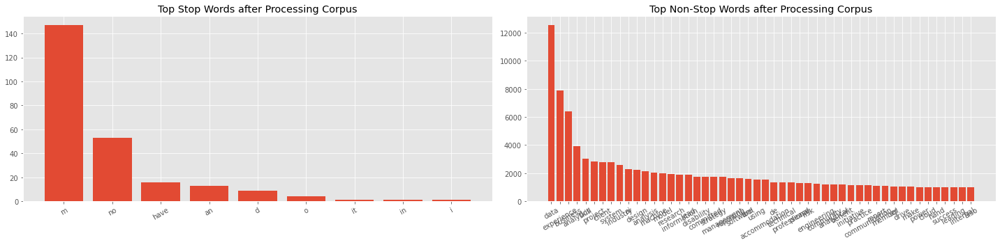

In [8]:
# plot top stop words in job descriptions
stop = stopwords.words('english')
desc_word = data['Descriptions'].str.split()
desc_words = desc_word.values.tolist()
corpus = [word for i in desc_words for word in i] # descriptions corpus
freq_dict = defaultdict(int) # get freq
for word in corpus:
    if word in stop: # check in stop corpus
        freq_dict[word] += 1 # if in, count 1 
top_stop = sorted(freq_dict.items(), key=lambda x:x[1], reverse=True)[:10] # sort, top 10
x_stop, y_stop = zip(*top_stop) # zip to x and y of plot
plt.figure(figsize=(20,5))
plt.subplot(1,2,1)
plt.bar(x_stop, y_stop)
plt.xticks(rotation=30)
plt.title('Top Stop Words after Processing Corpus')

# plot top non-stop words in job descriptions
counter = Counter(corpus) # count words in descriptions corpus
most = counter.most_common() # get most common nonstop words
x_nonstop, y_nonstop = [], []
for word,count in most[:50]: # top 50 
    if (word not in stop): # check not in stop corpus
        x_nonstop.append(word)
        y_nonstop.append(count)
plt.subplot(1,2,2)
plt.bar(x_nonstop, y_nonstop)
plt.xticks(rotation=30)
plt.title('Top Non-Stop Words after Processing Corpus')

plt.tight_layout()
plt.show()

##### a5) Visualisation

- Count plot group by location

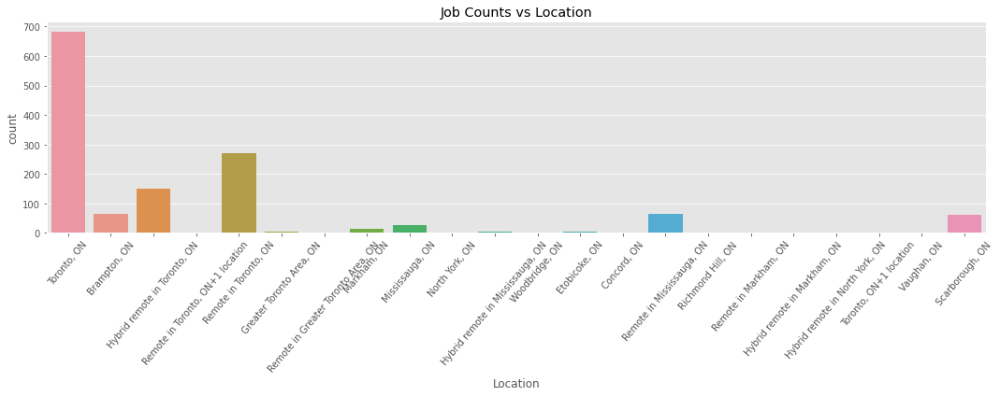

In [9]:
# count plot group by loc
plt.figure(figsize=(15, 6))
sns.countplot(x = 'Location', data = data)
plt.xticks(rotation=50)
plt.title('Job Counts vs Location')
plt.tight_layout()
plt.show()

- Visualise the job title distribution

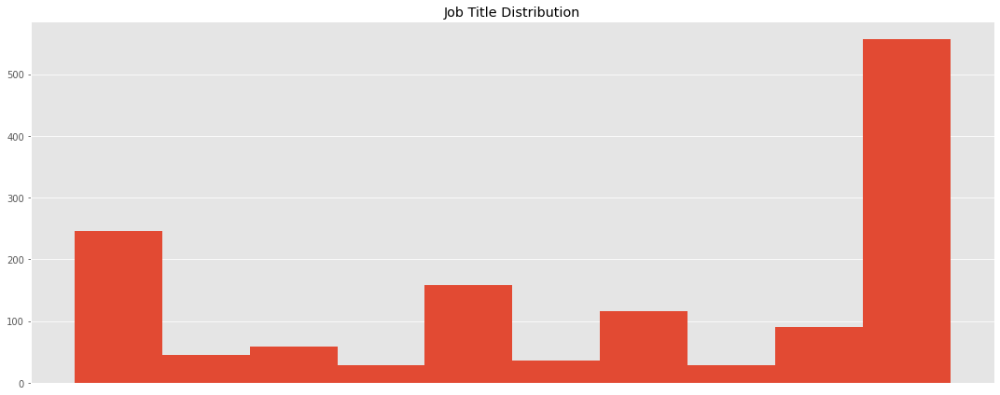

In [10]:
# job title distribution
plt.figure(figsize=(15, 6))
plt.hist(data.Title)
plt.xticks(ticks = [])
plt.title('Job Title Distribution')
plt.tight_layout()
plt.show()

- Keywords wordcloud of Descriptions according to title

unique job title number: 272


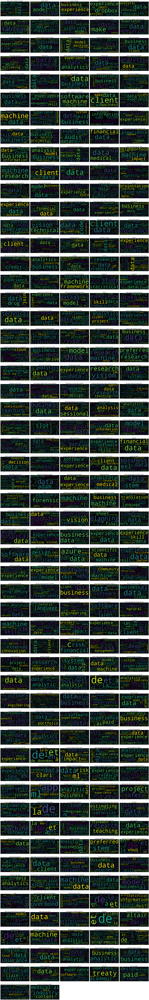

In [11]:
# Visualize keywords of Descriptions according to title
jobs_list = data.Title.unique().tolist()
print('unique job title number:', len(jobs_list))

col = 5
row = math.ceil(len(jobs_list)/col)

plt.figure(figsize=(30, 200))
gs = gridspec.GridSpec(row, col)
for i, job in enumerate(jobs_list):
    ax = plt.subplot(gs[i])
    # start with one review
    text = data[data.Title == job].iloc[0].Descriptions
    # create and generate a word cloud image
    wordcloud = WordCloud().generate(text)
    # display the generated image
    ax.imshow(wordcloud, interpolation='bilinear')
    ax.set_title(job)
    ax.axis("off")
plt.tight_layout()
plt.show()

##### a6) Use TF-IDF and Multinomial Naive Bayes Classifier to extract skills

- Modeling

In [12]:
# Converting text to features 
vectorizer = TfidfVectorizer()
# Tokenize features and build features vocabulary
X = vectorizer.fit_transform(data.Descriptions)
y = data.Title
# Fit model with entire data
clf = MultinomialNB(alpha=0.01)
clf.fit(X, y)
# Predict on entire data so that we can extract all unique job title
y_predicted = clf.predict(X)

- Check model performance

In [13]:
#evaluate the predictions
print("Accuracy score is: ",accuracy_score(y, y_predicted))

Accuracy score is:  0.9765395894428153


- Skill extraction with model

In [14]:
# skills keywords
technical_skills = ['python','numpy','panda','spark','scikit','pytorch','tensorflow','tableau','sql','fastai',
                    'hadoop','scala','django','ai','ui','machine','deep','visual','programming']
buiness_skills = ['statistic','predict','analyze','financial','innovation','management','interpersonal'
                  'communication','teamwork','creativity','ethic','solving','leadership','networking']      

feature_array = vectorizer.get_feature_names() # feature array
features_numbers = len(feature_array) # number of overall model features
n_max = int(features_numbers * 0.1) # max sorted features number
output = pd.DataFrame() # initialize output dataframe

for i in range(0,len(clf.classes_)):
    class_prob_ind_sorted = clf.feature_log_prob_[i, :].argsort()[::-1]
    all_skills = np.take(feature_array, class_prob_ind_sorted[:n_max])
    # extract technical skills
    ex_technical_skills = list(set(technical_skills).intersection(all_skills))
    # extract business skills
    ex_buiness_skills = list(set(buiness_skills).intersection(all_skills))
    # combine to a breif df
    output = output.append({'job_title':clf.classes_[i],
                            'technical_skills':ex_technical_skills,
                            'soft_skills':ex_buiness_skills},
                            ignore_index=True)

In [15]:
output = output.T # transpose (272 x 3)
output.head()

,0,1,2,3,4,5,6,7,8,9,...,262,263,264,265,266,267,268,269,270,271
job_title,account executive fixed income ai analytics,actuarial senior analyst specialist,adobe analytics engineer consultant,ai data engineering co op program,ai data engineering intern program,ai data scientist,ai engineering associate,ai ml researcher,ai programmer star war project,analyst,...,statistical analyst,statistical analyst data science,statistical programmer analyst,statistical programmer analyst intern,statistician,statistician research analyst,superintendent life science data centre constr...,team lead,technical lead,technical lead ml engineering natural language...
technical_skills,"[django, ai, fastai]","[django, fastai, programming]","[django, fastai, programming, tableau, python,...","[spark, pytorch, django, ai, fastai, programmi...","[spark, pytorch, ai, fastai, programming, pyth...","[django, ai, fastai, programming, sql, machine]","[pytorch, machine, django, ai, fastai, sql, pr...","[pytorch, machine, django, ai, fastai, visual,...","[fastai, ai, programming]","[spark, fastai, python, tableau, sql, machine]",...,"[django, fastai]","[django, fastai, numpy, programming, python, m...","[django, fastai, programming, python, sql]","[django, fastai, programming, python, sql]","[django, fastai]","[django, fastai, programming, tableau, python,...","[django, fastai]","[ai, fastai, programming, python, scala, table...","[machine, pytorch, django, ai, fastai, tensorf...","[pytorch, django, ai, fastai, programming, pyt..."
soft_skills,"[financial, ethic, management]","[statistic, management, ethic, financial]","[statistic, management, financial, creativity,...","[statistic, management, leadership, ethic]","[statistic, management, leadership, ethic]","[statistic, solving, ethic, financial]","[financial, ethic]","[statistic, management, ethic, financial]","[solving, ethic, innovation]","[statistic, management, innovation, financial,...",...,"[financial, ethic]","[statistic, solving, innovation, financial, et...","[statistic, management, analyze, financial, et...","[statistic, financial, ethic]","[statistic, analyze, ethic, innovation]","[statistic, financial, leadership, ethic]","[management, ethic]","[statistic, management, ethic, analyze]","[solving, ethic, financial]","[solving, creativity, leadership, ethic]"


#### b) Organize data into logically formatted data structure for clustering analysis

- Arrange extracted skills to each job title

In [16]:
# list for loop and assign skill to organised df for each sample
job_title_list = output.iloc[0].tolist() # outputted job title
techni_list = output.iloc[1].tolist() # outputted technical skills
buss_list = output.iloc[2].tolist() # outputted business skills
# organised df setting
data['Technical_skills'] = data['Title'] # set technical columns as title
data['Business_skills'] = data['Title'] # set technical columns as title
data['Technical_skills'] = data['Technical_skills'].astype('object') # change datatype to onject
data['Business_skills'] = data['Business_skills'].astype('object') # change datatype to onject

# loop and assign skills
for i, title in enumerate(job_title_list):
    for j in range(len(data)):
        if data.loc[j, 'Technical_skills'] == title: 
            data.at[j, 'Technical_skills'] = techni_list[i]
            data.at[j, 'Business_skills'] = buss_list[i]

- Organise data

In [17]:
data_cpy = data.copy(deep=True)
data_cpy = data_cpy.drop(['Rating', 'Date','Description','Links'], axis=1)
data_cpy

,Title,Company,Location,Salary,Descriptions,Technical_skills,Business_skills
0,data science analytics manager,GALE Partners,"Toronto, ON",NaN,data creative consultancy brings business stor...,"[spark, django, fastai, numpy, hadoop, tensorf...","[statistic, leadership, ethic]"
1,data scientist,Charger Logistics Inc,"Brampton, ON",NaN,charger logistics class asset carrier speciali...,"[spark, pytorch, ai, numpy, hadoop, programmin...","[statistic, analyze, management, leadership, p..."
2,senior manager,GALE Partners,"Hybrid remote in Toronto, ON",NaN,creative consultancy brings business storytell...,"[machine, pytorch, ai, numpy, hadoop, visual, ...","[analyze, management, leadership, solving, inn..."
3,machine learning intern,Dropbox,"Remote in Toronto, ON+1 location","$11,000 a month",description dropbox top notch experience backg...,"[deep, fastai, machine, django]","[solving, ethic]"
4,data science co op,Munich Re,"Hybrid remote in Toronto, ON",NaN,data na integrated analytics summer month data...,"[spark, machine, django, fastai, sql, python, ...","[statistic, management, leadership, financial,..."
...,...,...,...,...,...,...,...
1359,product manager safety ai,Veeva Systems,"Toronto, ON",NaN,nyse veev leader cloud software industry commi...,"[machine, django, ai, fastai, python, sql, deep]","[management, solving, innovation, financial, e..."
1360,postdoctoral fellow advanced machine learning ...,Sunnybrook Health Sciences Centre,"Toronto, ON",NaN,postdoctoral fellow machine technique neurosci...,"[pytorch, ai, fastai, programming, python, ten...","[ethic, predict]"
1361,senior data analyst,BDO,"Toronto, ON",NaN,putting first firm built foundation positive r...,"[spark, ai, programming, python, tableau, sql,...","[statistic, management, analyze, leadership, s..."
1362,project manager,TD SYNNEX,"Toronto, ON",NaN,project join established professional affect h...,"[ai, fastai, programming, python, sql, deep, m...","[statistic, management, leadership, innovation..."


#### c) Engineer features for clustering analysis

- Construct pre-encoded skill feature for dataframe

In [18]:
# find unique technical and business skills
all_t_skills = [t_skill for t_skills in data_cpy['Technical_skills'] for t_skill in t_skills]
all_b_skills = [b_skill for b_skills in data_cpy['Business_skills'] for b_skill in b_skills]
unique_t_skills = list(set(all_t_skills)) # use set to find unique
unique_b_skills = list(set(all_b_skills))

# create organised data
data_organised = data_cpy.copy(deep=True)
data_organised = data_organised.drop(['Descriptions', 'Technical_skills', 'Business_skills'], axis=1) # drop processed column to construct organised df

# create skills columns
for i in range(len(unique_t_skills)):
    data_organised['tech_'+unique_t_skills[i]] = 0 # set all technical skills to 0 first
for i in range(len(unique_b_skills)):
    data_organised['bus_'+unique_b_skills[i]] = 0 # set all business skills to 0 first

- Encode technical and business skills

In [19]:
# Technical_skills list encode to 
# ['tech_machine', 'tech_tableau', 'tech_sql', 'tech_scikit','tech_fastai', 'tech_pytorch', 'tech_scala', 'tech_python', 
# 'tech_programming', 'tech_panda', 'tech_tensorflow', 'tech_hadoop','tech_django', 'tech_ui', 'tech_deep', 'tech_ai', 
# 'tech_spark','tech_visual', 'tech_numpy']

for i, tech_skills in enumerate(data_cpy.Technical_skills): # each list in each technical skills row of data_cpy df
    for j, tech_skill in enumerate(tech_skills): # each element in list
        for k in range(len(data_organised.columns[4:23].tolist())): # each skill column name in data_organised
            if tech_skill == data_organised.columns[4:23].tolist()[k].split('_')[1]: # if element in list match skill name in organised df column, set 1
                data_organised[data_organised.columns[4+k]][i] = 1 

# Business_skills list encode to 
# ['bus_creativity', 'bus_innovation', 'bus_analyze', 'bus_networking', 'bus_ethic', 'bus_statistic', 
# 'bus_solving', 'bus_management', 'bus_financial', 'bus_leadership', 'bus_predict', 'bus_teamwork']
for i, bus_skills in enumerate(data_cpy.Business_skills): # each list in each business skills row of data_cpy df
    for j, bus_skill in enumerate(bus_skills): # each element in list
        for k in range(len(data_organised.columns[23:].tolist())): # each skill column name in data_organised
            if bus_skill == data_organised.columns[23:].tolist()[k].split('_')[1]: # if element in list match skill name in organised df column, set 1
                data_organised[data_organised.columns[23+k]][i] = 1            

- Rename Columns

In [20]:
new_columns = ['Title', 'Company', 'Location', 'Salary', 'Machine_Learning', 'Tableau', 'SQL', 'Scikit_Learn', 'FastAI','Pytorch', 'Scala', 'Python', 'Programming',
'Pandas', 'Tensorflow', 'Hadoop', 'Django', 'UI', 'Deep_Learning', 'AI', 'Spark', 'Data_Visualisation', 'Numpy', 'Creativity', 'Innovation', 
'Analyst', 'Networking', 'Ethic', 'Statistic', 'Problem_Solving', 'Management', 'Financial', 'Leadership', 'Predictive_Analytics', 'Teamwork']
# rename columns
data_organised.columns = new_columns
data_organised.head()

,Title,Company,Location,Salary,Machine_Learning,Tableau,SQL,Scikit_Learn,FastAI,Pytorch,...,Analyst,Networking,Ethic,Statistic,Problem_Solving,Management,Financial,Leadership,Predictive_Analytics,Teamwork
0,data science analytics manager,GALE Partners,"Toronto, ON",NaN,1,0,1,1,0,1,...,0,1,0,0,0,0,0,0,0,1
1,data scientist,Charger Logistics Inc,"Brampton, ON",NaN,0,1,1,1,0,1,...,1,1,1,1,0,1,1,1,1,0
2,senior manager,GALE Partners,"Hybrid remote in Toronto, ON",NaN,0,1,1,0,1,1,...,1,1,0,1,0,0,1,1,1,0
3,machine learning intern,Dropbox,"Remote in Toronto, ON+1 location","$11,000 a month",1,1,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
4,data science co op,Munich Re,"Hybrid remote in Toronto, ON",NaN,1,1,1,1,0,0,...,1,1,0,0,0,0,0,1,0,1


#### d) Visualize key information (you may consider some of the following visualizations)

- i. Wordcloud of technical/hard skills;
- ii. Wordcloud of business/soft skills;
- iii. Wordcloud of all skills;

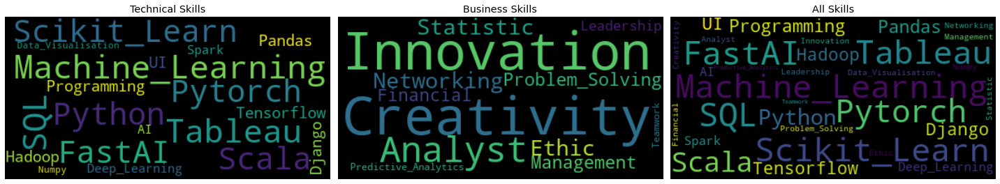

In [21]:
# word cloud on technical skills
tech_wordcloud = data_organised.columns[4:23].tolist()
tech_wordcloud = " ".join(tech_wordcloud)
tech_wordcloud = WordCloud().generate(tech_wordcloud)
# word cloud on business skills
busi_wordcloud = data_organised.columns[23:].tolist()
busi_wordcloud = " ".join(busi_wordcloud)
busi_wordcloud = WordCloud().generate(busi_wordcloud)
# word cloud on  all skills
all_wordcloud = data_organised.columns[4:].tolist()
all_wordcloud = " ".join(all_wordcloud)
all_wordcloud = WordCloud().generate(all_wordcloud)
# plot
plt.figure(figsize=(20, 8))
plt.subplot(1,3,1)
plt.imshow(tech_wordcloud, interpolation='bilinear')
plt.title('Technical Skills')
plt.axis("off")
plt.subplot(1,3,2)
plt.imshow(busi_wordcloud, interpolation='bilinear')
plt.title('Business Skills')
plt.axis("off")
plt.subplot(1,3,3)
plt.imshow(all_wordcloud, interpolation='bilinear')
plt.title('All Skills')
plt.axis("off")

plt.tight_layout()
plt.show()

### 3.Hierarchical clustering implementation

#### a) Implement hierarchical clustering algorithm

In [22]:
clusters  = linkage(data_organised.loc[:,'Machine_Learning':].T, method='ward')

#### b) Generate and plot a dendrogram from hierarchical clustering algorithm

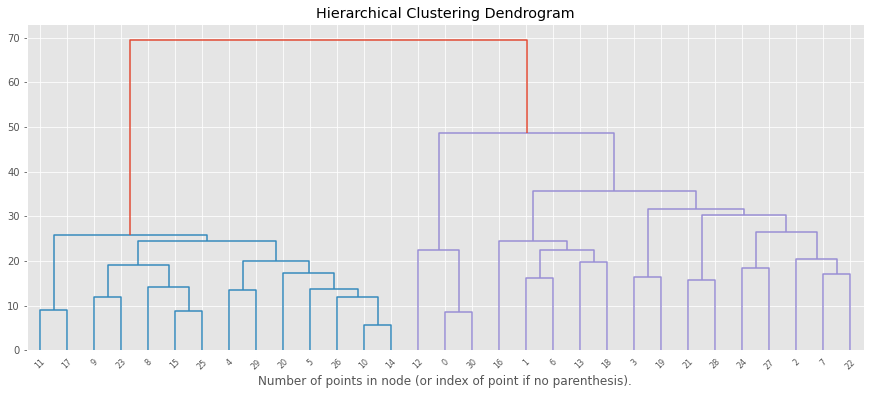

In [23]:
fig1 = plt.figure(figsize=(15,6))
dengraph = dendrogram(Z=clusters) #, truncate_mode="level", p=3)
plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

#### c) Decide about a number of clusters that you would like to select keeping in mind that you need to design a sequence of 8-12 courses. Justify and explain your clusters in one paragraph.|

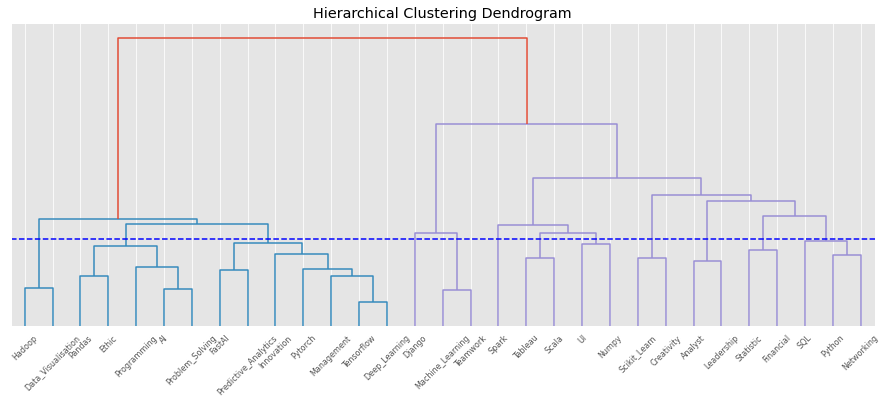

In [24]:
fig = plt.figure(figsize=(30, 7))
ax1 = fig.add_axes([0.1,0.1,0.4,0.6])
dengraph = dendrogram(Z=clusters) #, truncate_mode="level", p=3)
# set dendrogram xticks
couse_list_unsort = data_organised.loc[:,'Machine_Learning':].T.index.tolist()
labels_hier = []
for i in range(len(couse_list_unsort)):
    labels_hier.append(couse_list_unsort[dengraph['leaves'][i]])

plt.axhline(y = 21, color = 'blue', linestyle = '--')
plt.title("Hierarchical Clustering Dendrogram")
ax1.set_yticks([])
ax1.set_xticklabels(labels_hier)
plt.tight_layout()
plt.show()

In [25]:
print(
'''
With threshold of 21, we have 12 clusters.
From Figure above, with threshold of 21, we have 12 clusters so that we can design a sequence
of 12 courses.
    - Course 1 Deep Learning, topic: Deep Learning, AI
    - Course 2 Financial Engineering, topic: Spark, Financial, Tableau, Programming, Leadership
    - Course 3 Predictive Analytics, topic: Hadoop, Ethic, Creativity, Pytorch, Predictive Analytics, Django, Numpy
    - Course 4 Python, topic: Python
    - Course 5 UI, topic: UI, Problem Sovling
    - Course 6 Machine Learning, topic: Machine Learning
    - Course 7 AI, topic: FastAI, Tensorflow
    - Course 8 Data Analytics I, topic: SQL, Scala
    - Course 9 Scikit Learn, topic: Scikit Learn, Innovation
    - Course 10 Statistics for Management, topic: Statistic, Management
    - Course 11 Data Analytics II, topic: Analyst, Teamwork
    - Course 12 Data Visualisation, topic: Pandas, Data Visualisation, Networking
'''
)


With threshold of 21, we have 12 clusters.
From Figure above, with threshold of 21, we have 12 clusters so that we can design a sequence
of 12 courses.
    - Course 1 Deep Learning, topic: Deep Learning, AI
    - Course 2 Financial Engineering, topic: Spark, Financial, Tableau, Programming, Leadership
    - Course 3 Predictive Analytics, topic: Hadoop, Ethic, Creativity, Pytorch, Predictive Analytics, Django, Numpy
    - Course 4 Python, topic: Python
    - Course 5 UI, topic: UI, Problem Sovling
    - Course 6 Machine Learning, topic: Machine Learning
    - Course 7 AI, topic: FastAI, Tensorflow
    - Course 8 Data Analytics I, topic: SQL, Scala
    - Course 9 Scikit Learn, topic: Scikit Learn, Innovation
    - Course 10 Statistics for Management, topic: Statistic, Management
    - Course 11 Data Analytics II, topic: Analyst, Teamwork
    - Course 12 Data Visualisation, topic: Pandas, Data Visualisation, Networking



### 4.K-means or DBSCAN clustering implementation

#### a) Implement k-means clustering algorithm or DBSCAN clustering algorithm

- K-means clustering with elbow method

In [26]:
kmean_data = data_organised.copy(deep=True)
X = kmean_data.loc[:, 'Machine_Learning':]
X_arr = np.array(X)

kmeans = KMeans(n_clusters = 12, 
                init = 'k-means++',
                n_init = 10,
                max_iter = 300,
                random_state = 0)
kmeans.fit(X_arr)
labels = kmeans.labels_
data_organised['KMeans_Clusters'] = labels
print("Distortion: %.2f" % kmeans.inertia_)

Distortion: 2322.91


In [27]:
data_organised.head(2)

,Title,Company,Location,Salary,Machine_Learning,Tableau,SQL,Scikit_Learn,FastAI,Pytorch,...,Networking,Ethic,Statistic,Problem_Solving,Management,Financial,Leadership,Predictive_Analytics,Teamwork,KMeans_Clusters
0,data science analytics manager,GALE Partners,"Toronto, ON",NaN,1,0,1,1,0,1,...,1,0,0,0,0,0,0,0,1,9
1,data scientist,Charger Logistics Inc,"Brampton, ON",NaN,0,1,1,1,0,1,...,1,1,1,0,1,1,1,1,0,10


#### b) Decide about a number of clusters that you would like to select keeping in mind that you need to design a sequence of 8-12 courses. For instance, you can use the elbow method to determine the optimal number of clusters for k-means clustering or experiment with different eps values if using DBSCAN clustering. Justify and explain your clusters in one paragraph

- when k = 9, above figure presents an elbow shape

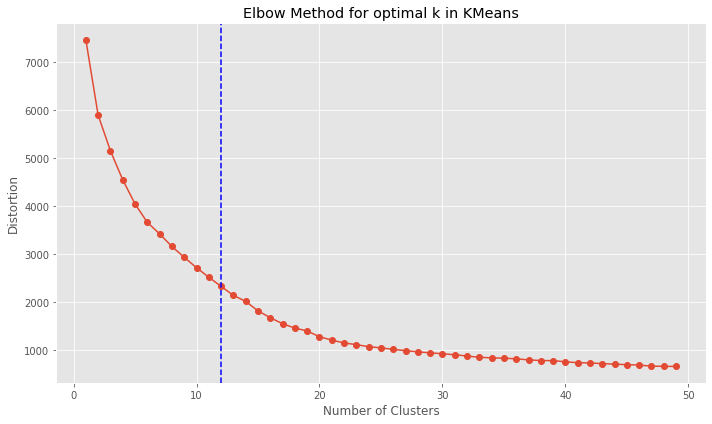

In [28]:
# elbow method
distortions = []
cluster_range = [i for i in range(1, 50)]
for i in cluster_range:
    km=KMeans(n_clusters = i,
              init = 'k-means++', # avoid the central initialization problem
              n_init = 10,
              max_iter = 300,
              random_state = 0)
    km.fit(X)
    distortions.append(km.inertia_)
plt.figure(figsize=(10,6))
plt.plot(cluster_range, distortions, marker='o')
plt.axvline(x = 12, color = 'blue', linestyle = '--')
plt.xlabel("Number of Clusters")
plt.ylabel("Distortion")
plt.title('Elbow Method for optimal k in KMeans')
plt.tight_layout()
plt.show()

#### c) Visualize your clustering results, e.g., using a labeled scatterplot from k-means clustering algorithm or DBSCAN clustering algorithm

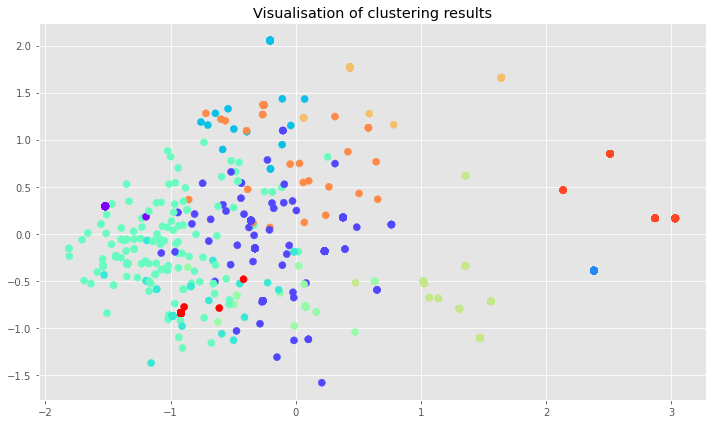

In [29]:
plt.figure(figsize=(10,6))
X_pca = PCA(2).fit_transform(X) # pca to reduce dimension to 2
c = data_organised.KMeans_Clusters
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=c, s=50, cmap='rainbow')
plt.title('Visualisation of clustering results')
plt.tight_layout()
plt.show()

### 5.Interpretation of results, discussion and final course curriculum

Separately visualize course curricula (course names and topics taught in each course) from Section 3 (hierarchical clustering algorithm) and from Section 4 (second clustering algorithm). For each course include 3-8 topics (based on skills) that should be taught in each course. Discuss and compare your course curriculum from Section 3 and from Section 4. Present and justify your final course curriculum. You may select curriculum from Section 3 or from Section 4 as your final course curriculum. If you design and justify a creative way to combine results of two clustering algorithms into final course curriculum you will get one bonus point (your max assignment mark cannot exceed 15 pts, including bonus)

- Course Curricula from Section 3

In [30]:
course_dict =  {'Deep_Learning': ['Deep_Learning', 'AI'], 
                'Financial Engineering': ['Spark', 'Financial', 'Tableau', 'Programming', 'Leadership'],
                'Predictive Analytics': ['Hadoop', 'Ethic', 'Creativity', 'Pytorch', 'Predictive' 'Analytics', 'Django', 'Numpy'],
                'Python': ['Python'],
                'UI': ['UI', 'Problem Sovling'],
                'Machine Learning': ['Machine Learning'],
                'AI': ['FastAI', 'Tensorflow'],
                'Data Analytics I': ['SQL', 'Scala'],
                'Scikit Learn': ['Scikit_Learn', 'Innovation'],
                'Statistics for Management': ['Statistic', 'Management'],
                'Data Analytics II': ['Analyst', 'Teamwork'],
                'Data Visualisation': ['Pandas', 'Data Visualisation', 'Networking']
}
course_name = list(course_dict.keys())

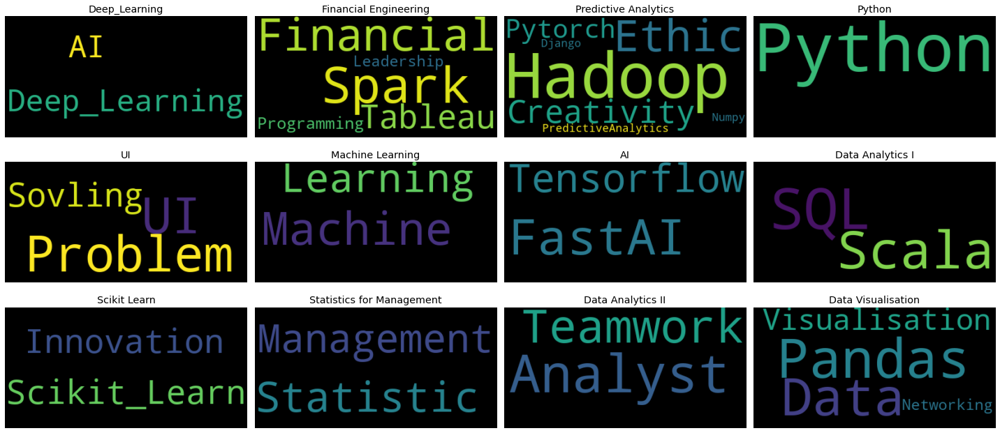

In [31]:
plt.figure(figsize=(20, 9))
gs = gridspec.GridSpec(3, 4)
for i in range(12):
    ax = plt.subplot(gs[i])
    courses = course_dict[course_name[i]]
    courses = " ".join(courses)
    coursescloud = WordCloud().generate(courses)
    ax.imshow(coursescloud, interpolation='bilinear')
    ax.set_title(course_name[i])
    ax.axis("off")
plt.tight_layout()
plt.show()

- Course Curricula from Section 4

In [32]:
course_data_org = data_organised.copy(deep=True) # copy df
course_data_org['sum_count'] = course_data_org.loc[:,'Machine_Learning':'Teamwork'].sum(axis=1) # get course count

In [33]:
def course_curricula_filter(course_id):
    course = course_data_org[course_data_org.KMeans_Clusters == course_id] # course cluster number
    course = course[course.sum_count == course.sum_count.max()] # get course count with max 
    course = course.loc[:, 'Machine_Learning':'Teamwork']
    topics = course.sum() # sum up topic counts
    topics = topics.sort_values(ascending=False)[:5]
    topics = topics.index.tolist()
    return topics

In [34]:
courses_topics_list =[]
course_names = ['UI I', 'Data Management I', 'Data Visualisation I', 'Machine Learning I',
                'Data Analytics I', 'AI', 'Financial Engineering', 'UI II',
                'Statistics for Management', 'UI III', 'Machine Learning II', 'Machine Learning III'
                ]
courses_dict = {}
for i in range(12):
    course_topics = course_curricula_filter(i)
    courses_dict[course_names[i]] = course_topics
    course_topics = " ".join(course_topics)
    courses_topics_list.append(course_topics)

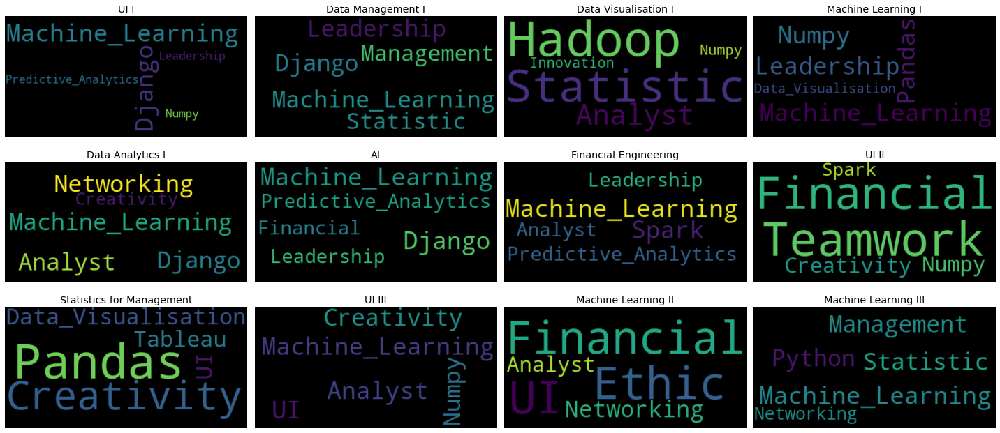

In [35]:
plt.figure(figsize=(20, 9))
gs = gridspec.GridSpec(3, 4)
for i in range(12):
    ax = plt.subplot(gs[i])
    courses_topics_cloud = WordCloud().generate(courses_topics_list[i])
    ax.imshow(courses_topics_cloud, interpolation='bilinear')
    ax.set_title(course_names[i])
    ax.axis("off")
plt.tight_layout()
plt.show()

In [36]:
print(
'''
- Course curriculum comparison between section 3 and section 4:
    - Although most of curriculums in section 4 has overlapped topic, the curriculum in section 3 is not as detailed as in section 4.
      Moreover, each curriculums in section 3 has fewer topics.

- Selection and Justification of Final course curriculum
    - Final course curriculum will be the result of section 4.
        - {}: {}
        - {}: {}
        - {}: {}
        - {}: {}
        - {}: {}
        - {}: {}
        - {}: {}
        - {}: {}
        - {}: {}
        - {}: {}
        - {}: {}
    - Justification:
        - Based on the elbow method, 12 is the optimal k in Kmeans Clustering. The optimal solution of the Kmeans parameter is to 
          minimize the cost function as the goal. The cost function is the sum of the degree of distortion of each class. The degree 
          of distortion of each class is equal to the sum of squares of distances between center of gravity of class and its internal
          member positions. However, the average degree of distortion will first decrease and then increase with the increase of K, 
          so the minimum average degree of distortion can be obtained. Then since samples are different job titles, the existing skills
          (feature) in each sample present as 1, by grouping the job titles with cluster number, summing the count of skills and finding 
          the top 5 skills with max count, the top 5 topics in each cluster (course) are decided as main topics for that courses.
    
'''.format(course_names[0], courses_dict[course_names[0]],
           course_names[1], courses_dict[course_names[1]],
           course_names[2], courses_dict[course_names[2]],
           course_names[3], courses_dict[course_names[3]],
           course_names[4], courses_dict[course_names[4]],
           course_names[5], courses_dict[course_names[5]],
           course_names[6], courses_dict[course_names[6]],
           course_names[7], courses_dict[course_names[7]],
           course_names[8], courses_dict[course_names[8]],
           course_names[9], courses_dict[course_names[9]],
           course_names[10], courses_dict[course_names[10]],
           course_names[11], courses_dict[course_names[11]])
)


- Course curriculum comparison between section 3 and section 4:
    - Although most of curriculums in section 4 has overlapped topic, the curriculum in section 3 is not as detailed as in section 4.
      Moreover, each curriculums in section 3 has fewer topics.

- Selection and Justification of Final course curriculum
    - Final course curriculum will be the result of section 4.
        - UI I: ['Machine_Learning', 'Django', 'Predictive_Analytics', 'Leadership', 'Numpy']
        - Data Management I: ['Machine_Learning', 'Django', 'Leadership', 'Management', 'Statistic']
        - Data Visualisation I: ['Hadoop', 'Statistic', 'Analyst', 'Innovation', 'Numpy']
        - Machine Learning I: ['Machine_Learning', 'Pandas', 'Leadership', 'Numpy', 'Data_Visualisation']
        - Data Analytics I: ['Machine_Learning', 'Django', 'Networking', 'Analyst', 'Creativity']
        - AI: ['Machine_Learning', 'Django', 'Predictive_Analytics', 'Leadership', 'Financial']
        - Financial Engineering